In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot

from math import sqrt
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

from sklearn.metrics import root_mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import warnings

In [2]:
import pandas as pd
train_df=pd.read_csv('train.csv')
features_df=pd.read_csv('features.csv')
stores_df=pd.read_csv('stores.csv')
test_df=pd.read_csv('test.csv')
                    

In [3]:
train_df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [4]:
train_df.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday'], dtype='object')

In [5]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Store         421570 non-null  int64  
 1   Dept          421570 non-null  int64  
 2   Date          421570 non-null  object 
 3   Weekly_Sales  421570 non-null  float64
 4   IsHoliday     421570 non-null  bool   
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB


In [6]:
train_df.describe()

,Store,Dept,Weekly_Sales
count,421570.000000,421570.000000,421570.000000
mean,22.200546,44.260317,15981.258123
std,12.785297,30.492054,22711.183519
min,1.000000,1.000000,-4988.940000
25%,11.000000,18.000000,2079.650000
50%,22.000000,37.000000,7612.030000
75%,33.000000,74.000000,20205.852500
max,45.000000,99.000000,693099.360000


In [7]:
train_df.isnull().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
dtype: int64

In [8]:
features_df.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [9]:
features_df.columns

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday'],
      dtype='object')

In [10]:
features_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
dtypes: bool(1), float64(9), int64(1), object(1)
memory usage: 712.0+ KB


In [11]:
features_df.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000


In [12]:
features_df.isnull().sum()

Store              0
Date               0
Temperature        0
Fuel_Price         0
MarkDown1       4158
MarkDown2       5269
MarkDown3       4577
MarkDown4       4726
MarkDown5       4140
CPI              585
Unemployment     585
IsHoliday          0
dtype: int64

In [13]:
stores_df.head()


,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [14]:
stores_df.shape

(45, 3)

In [15]:
stores_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45 entries, 0 to 44
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Store   45 non-null     int64 
 1   Type    45 non-null     object
 2   Size    45 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 1.2+ KB


In [16]:
stores_df.describe()

,Store,Size
count,45.000000,45.000000
mean,23.000000,130287.600000
std,13.133926,63825.271991
min,1.000000,34875.000000
25%,12.000000,70713.000000
50%,23.000000,126512.000000
75%,34.000000,202307.000000
max,45.000000,219622.000000


In [17]:
stores_df.isnull().sum()

Store    0
Type     0
Size     0
dtype: int64

##### Visualizing the Type of the Storess along with their percentage

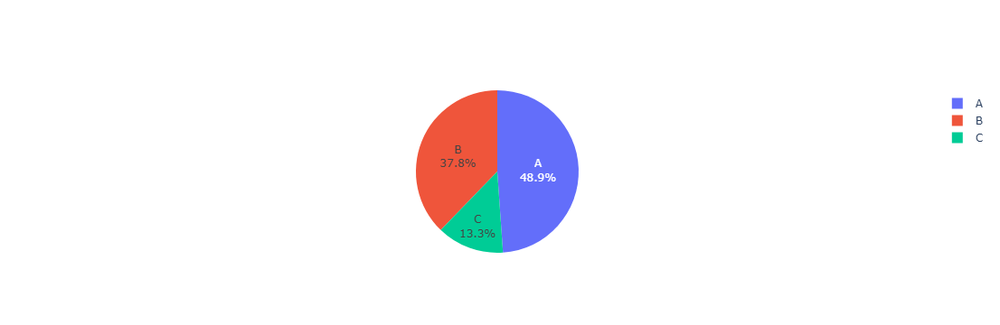

In [19]:
import plotly.graph_objs as go

labels = stores_df['Type'].value_counts()[:10].index
values = stores_df['Type'].value_counts()[:10].values

colors=stores_df['Type']
fig= go.Figure(data=[go.Pie(labels = labels, values= values, textinfo='label+percent', marker=dict(colors=colors))])
fig.show()

Type A has the max number of store

Since features and stores have 'Store' as a common column lets merge the data

In [22]:
#Using the merge function to merge ans we are merging along the common column named store
dataset = features_df.merge(stores_df, how='inner', on='Store')
dataset.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,A,151315
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True,A,151315
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False,A,151315
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False,A,151315
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False,A,151315


In [23]:
stores_df.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [24]:
#Total number of columns in the dataset
dataset.columns

Index(['Store', 'Date', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2',
       'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment',
       'IsHoliday', 'Type', 'Size'],
      dtype='object')

In [25]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
 12  Type          8190 non-null   object 
 13  Size          8190 non-null   int64  
dtypes: bool(1), float64(9), int64(2), object(2)
memory usage: 839.9+ KB


In [26]:
#describing dataset
dataset.describe()

,Store,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size
count,8190.000000,8190.000000,8190.000000,4032.000000,2921.000000,3613.000000,3464.000000,4050.000000,7605.000000,7605.000000,8190.000000
mean,23.000000,59.356198,3.405992,7032.371786,3384.176594,1760.100180,3292.935886,4132.216422,172.460809,7.826821,130287.600000
std,12.987966,18.678607,0.431337,9262.747448,8793.583016,11276.462208,6792.329861,13086.690278,39.738346,1.877259,63115.971429
min,1.000000,-7.290000,2.472000,-2781.450000,-265.760000,-179.260000,0.220000,-185.170000,126.064000,3.684000,34875.000000
25%,12.000000,45.902500,3.041000,1577.532500,68.880000,6.600000,304.687500,1440.827500,132.364839,6.634000,70713.000000
50%,23.000000,60.710000,3.513000,4743.580000,364.570000,36.260000,1176.425000,2727.135000,182.764003,7.806000,126512.000000
75%,34.000000,73.880000,3.743000,8923.310000,2153.350000,163.150000,3310.007500,4832.555000,213.932412,8.567000,202307.000000
max,45.000000,101.950000,4.468000,103184.980000,104519.540000,149483.310000,67474.850000,771448.100000,228.976456,14.313000,219622.000000


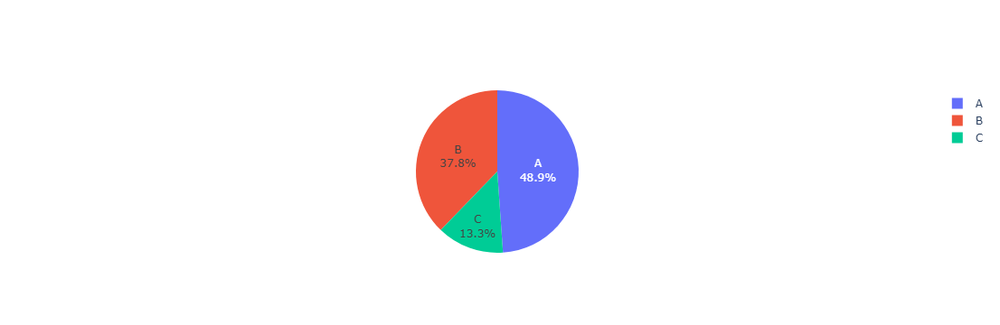

In [27]:
labels = dataset['Type'].value_counts()[:10].index
values = dataset['Type'].value_counts()[:10].values

colors=stores_df['Type']
fig= go.Figure(data=[go.Pie(labels = labels, values= values, textinfo='label+percent', marker=dict(colors=colors))])
fig.show()

Type A has maximum number of stores

##### Lets Get the datatype info of test dataset`

In [30]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115064 entries, 0 to 115063
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   Store      115064 non-null  int64 
 1   Dept       115064 non-null  int64 
 2   Date       115064 non-null  object
 3   IsHoliday  115064 non-null  bool  
dtypes: bool(1), int64(2), object(1)
memory usage: 2.7+ MB


###### Here Date is of string type

Visualizing the top 10 Department in the train dataset along with their percentage

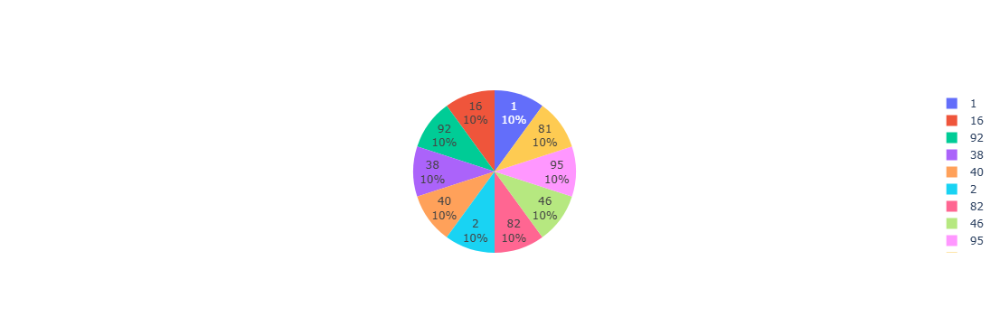

In [33]:
labels = train_df['Dept'].value_counts()[:10].index
values = train_df['Dept'].value_counts()[:10].values

colors=train_df['Dept']
fig= go.Figure(data=[go.Pie(labels = labels, values= values, textinfo='label+percent', marker=dict(colors=colors))])
fig.show()

Visualizing the top 10 store in the train dataset along with their percentage

##### Visualizing the Store Data

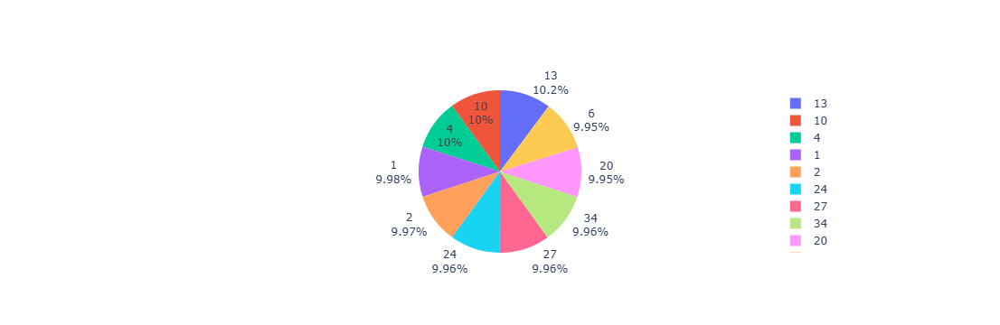

In [36]:
labels = train_df['Store'].value_counts()[:10].index
values = train_df['Store'].value_counts()[:10].values

colors=train_df['Store']
fig= go.Figure(data=[go.Pie(labels = labels, values= values, textinfo='label+percent', marker=dict(colors=colors))])
fig.show()

##### Visualizing the IsHoliday Data

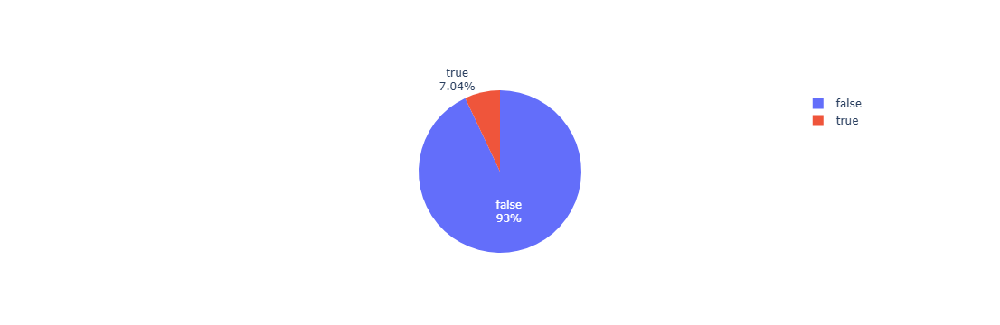

In [38]:
labels = train_df['IsHoliday'].value_counts()[:10].index
values = train_df['IsHoliday'].value_counts()[:10].values

colors=train_df['IsHoliday']
fig= go.Figure(data=[go.Pie(labels = labels, values= values, textinfo='label+percent', marker=dict(colors=colors))])
fig.show()

As per the plot for the 93% of the time there is no Holiday

In [40]:
#Total noumber of columns in the test_df
test_df.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday'], dtype='object')

In [41]:
test_df.describe()

,Store,Dept
count,115064.000000,115064.000000
mean,22.238207,44.339524
std,12.809930,30.656410
min,1.000000,1.000000
25%,11.000000,18.000000
50%,22.000000,37.000000
75%,33.000000,74.000000
max,45.000000,99.000000


In [42]:
from datetime import datetime
train_df['Date'] = pd.to_datetime(train_df['Date'])
test_df['Date']= pd.to_datetime(test_df['Date'])

In [43]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   Store         421570 non-null  int64         
 1   Dept          421570 non-null  int64         
 2   Date          421570 non-null  datetime64[ns]
 3   Weekly_Sales  421570 non-null  float64       
 4   IsHoliday     421570 non-null  bool          
dtypes: bool(1), datetime64[ns](1), float64(1), int64(2)
memory usage: 13.3 MB


In [44]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
 12  Type          8190 non-null   object 
 13  Size          8190 non-null   int64  
dtypes: bool(1), float64(9), int64(2), object(2)
memory usage: 839.9+ KB


In [45]:
dataset['Date'] = pd.to_datetime(dataset['Date'])
dataset['Week'] = dataset.Date.dt.isocalendar().week
dataset['Year'] = dataset.Date.dt.year

In [46]:
dataset.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size,Week,Year
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,A,151315,5,2010
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True,A,151315,6,2010
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False,A,151315,7,2010
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False,A,151315,8,2010
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False,A,151315,9,2010


In [47]:
#Merging with train_df
train_merge = train_df.merge(dataset, how='inner', on=['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date'])


In [48]:
#Merging with test_df
test_merge = test_df.merge(dataset, how='inner', on =['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date'])

In [49]:


def scatter(train_merge, column):
    plt.figure()
    plt.scatter(train_merge[column], train_merge['Weekly_Sales'])
    plt.ylabel('Weekly_sales')
    plt.xlabel(column)
    

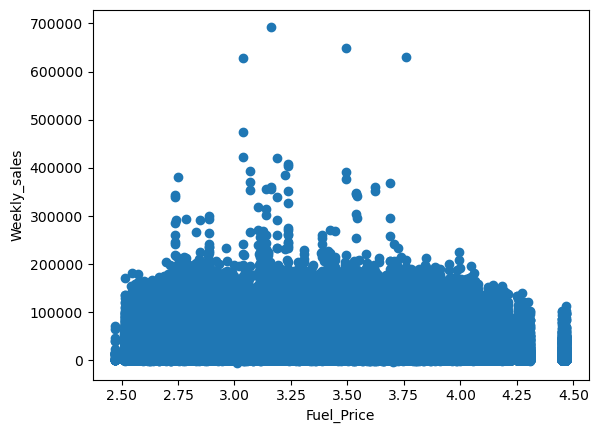

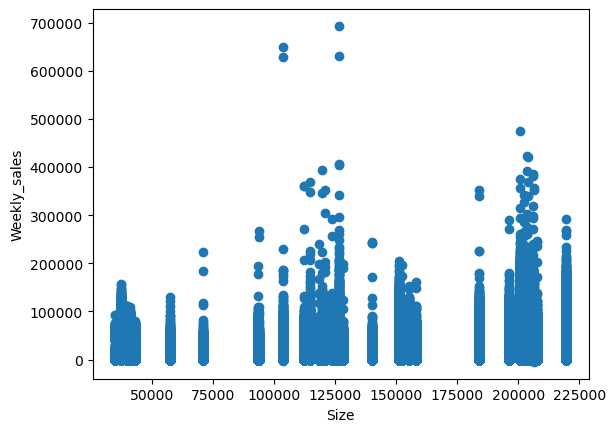

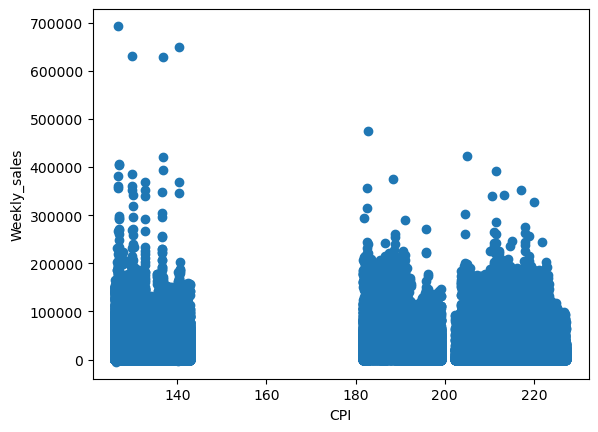

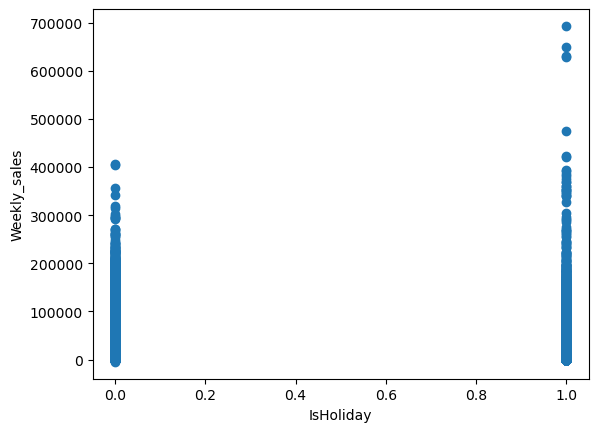

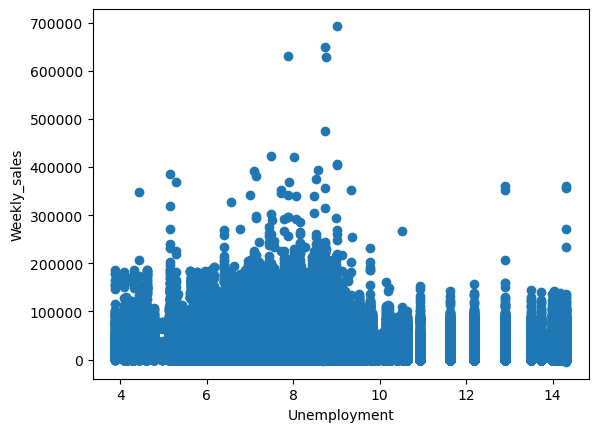

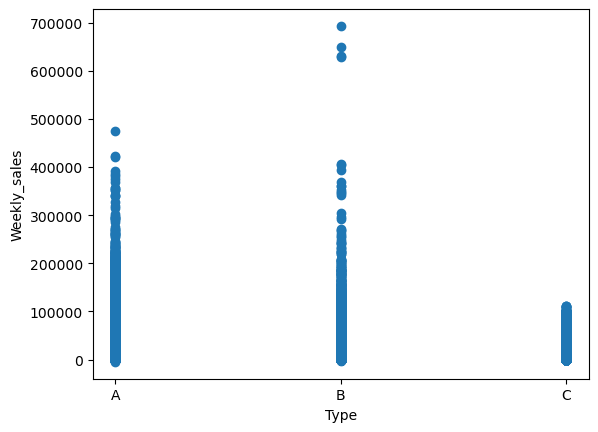

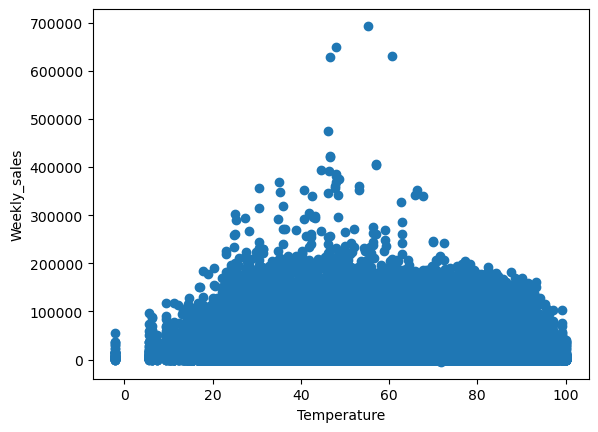

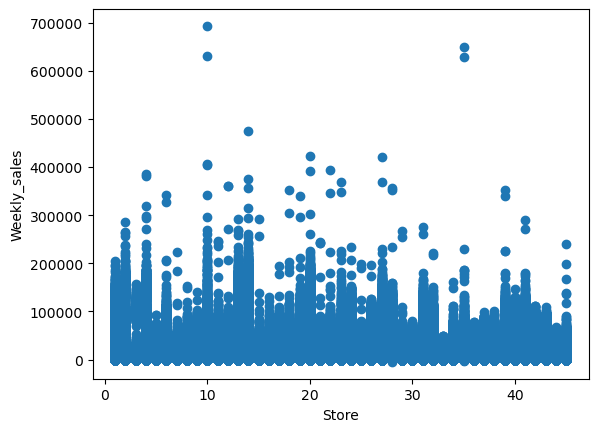

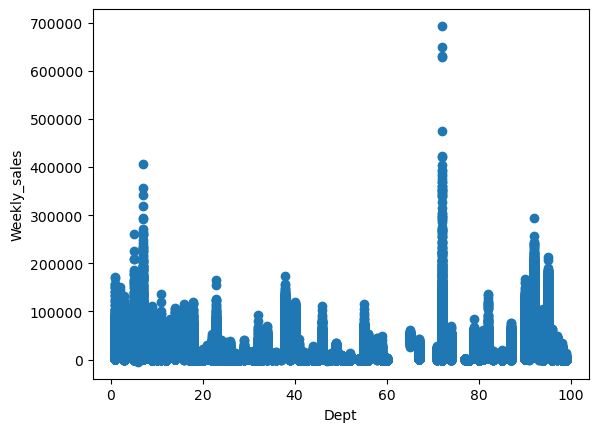

In [50]:
import matplotlib.pyplot as plt
scatter(train_merge, 'Fuel_Price') #with respect to fuel price
scatter(train_merge, 'Size') #with respect to size
scatter(train_merge, 'CPI') #with respect to cpi
scatter(train_merge, 'IsHoliday') #with respect ot isholiday
scatter(train_merge, 'Unemployment') #with respect ot unemployment
scatter(train_merge, 'Type')#with respect to type
scatter(train_merge, 'Temperature') #with respect ot Temperature
scatter(train_merge, 'Store') #with respect o store
scatter(train_merge, 'Dept')  #with respect to dept


#### Correlation Matrix

###### Lets have a look at the Average Sales per year and find oout if there is any holiday peak sales that were not considered by IsHoliday filed

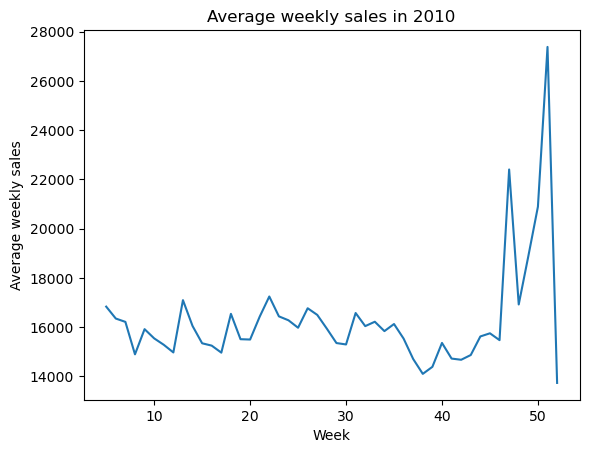

In [53]:
#Average Weekly Sales for the year 2010
import matplotlib.pyplot as plt
import seaborn as sns
weekly_sales_2010 = train_merge[train_merge['Year']==2010]['Weekly_Sales'].groupby(train_merge['Week']).mean() 

sns.lineplot(x=weekly_sales_2010.index, y=weekly_sales_2010.values)
plt.xlabel('Week')
plt.ylabel('Average weekly sales')
plt.title('Average weekly sales in 2010')
plt.show()

# for plotting then lineplot

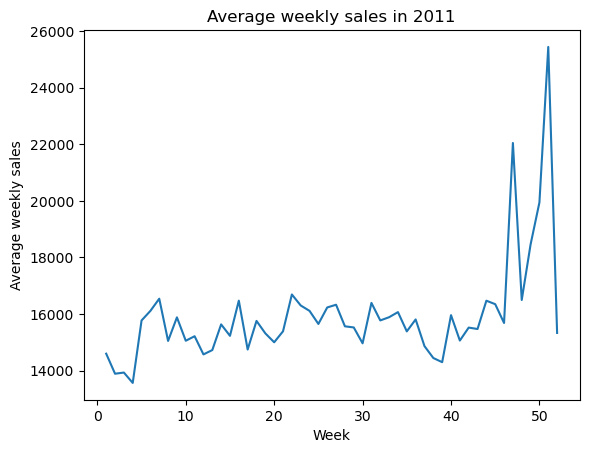

In [54]:
weekly_sales_2011 = train_merge[train_merge['Year']==2011]['Weekly_Sales'].groupby(train_merge['Week']).mean() 

sns.lineplot(x=weekly_sales_2011.index, y=weekly_sales_2011.values)
plt.xlabel('Week')
plt.ylabel('Average weekly sales')
plt.title('Average weekly sales in 2011')
plt.show()



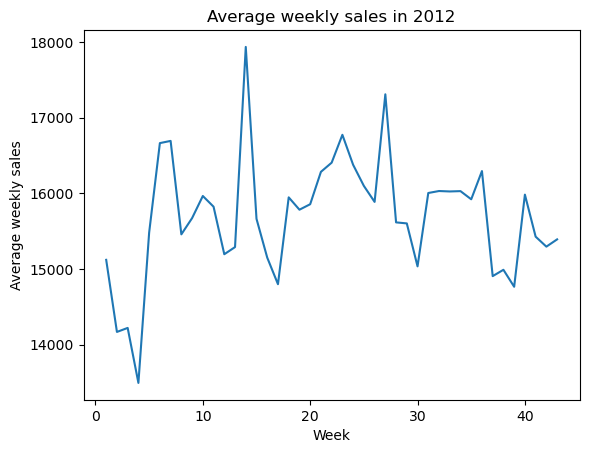

In [55]:
weekly_sales_2012 = train_merge[train_merge['Year']==2012]['Weekly_Sales'].groupby(train_merge['Week']).mean() 

sns.lineplot(x=weekly_sales_2012.index, y=weekly_sales_2012.values)
plt.xlabel('Week')
plt.ylabel('Average weekly sales')
plt.title('Average weekly sales in 2012')
plt.show()

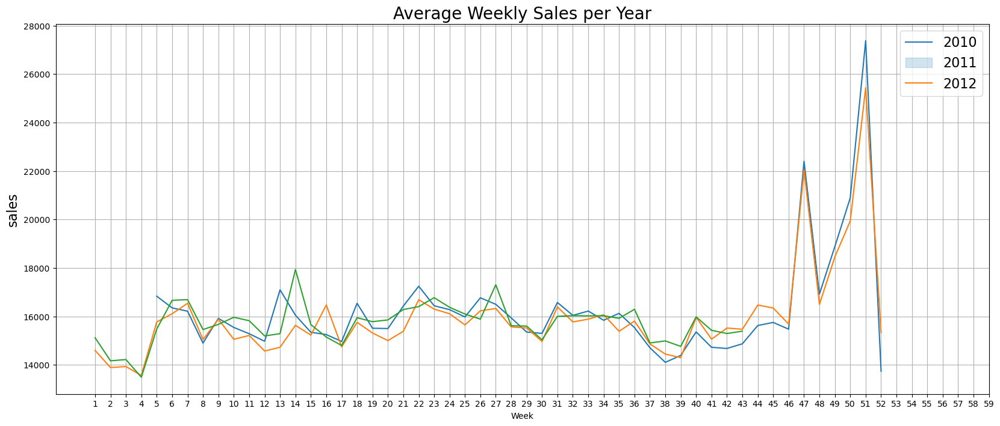

In [56]:
#Plotting the above three plot together
import numpy as np
plt.figure(figsize=(20,8))
sns.lineplot(x=weekly_sales_2010.index, y=weekly_sales_2010.values)
sns.lineplot(x=weekly_sales_2011.index, y=weekly_sales_2011.values)
sns.lineplot(x=weekly_sales_2012.index, y=weekly_sales_2012.values)
plt.grid()
plt.xticks(np.arange(1,60, step=1))
plt.legend(['2010','2011','2012'], loc='best', fontsize=16)
plt.title('Average Weekly Sales per Year', fontsize=20)
plt.ylabel('sales', fontsize=16)
plt.show()


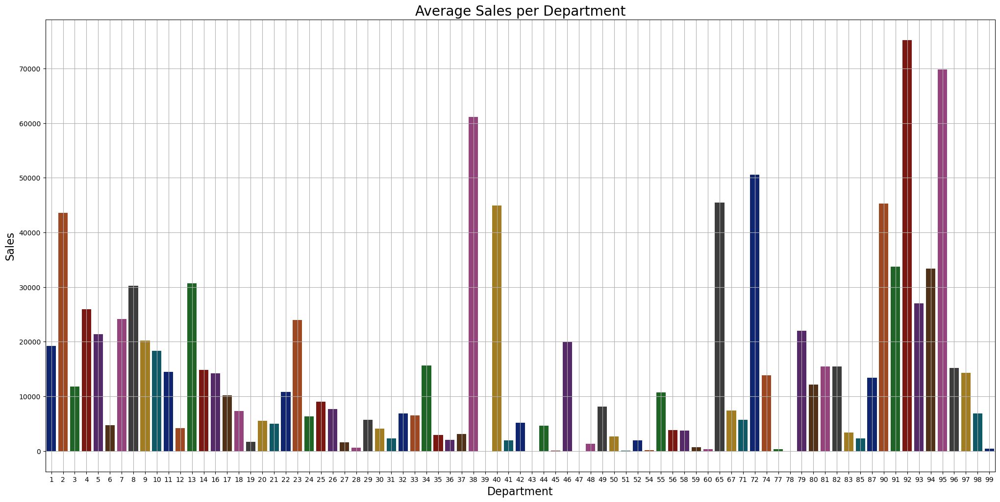

In [57]:
# Average Sales per Department
weekly_sales = train_merge['Weekly_Sales'].groupby(train_merge['Dept']).mean()
plt.figure(figsize=(25, 12))
sns.barplot(x=weekly_sales.index, y=weekly_sales.values, hue=weekly_sales.index, legend=False, palette='dark')
plt.grid()
plt.title('Average Sales per Department', fontsize=20)
plt.xlabel('Department', fontsize=16)
plt.ylabel('Sales', fontsize=16)

plt.show()

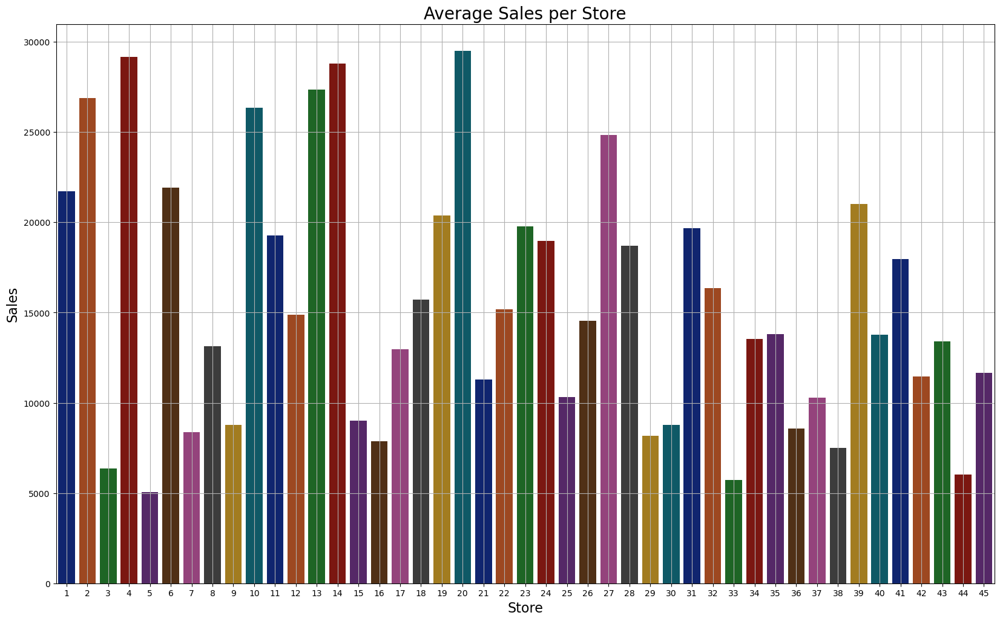

In [58]:
# Average Sales per store
weekly_sales = train_merge['Weekly_Sales'].groupby(train_merge['Store']).mean()
plt.figure(figsize=(20, 12))
sns.barplot(x=weekly_sales.index, y=weekly_sales.values, hue=weekly_sales.index, legend=False, palette='dark')
plt.grid()
plt.title('Average Sales per Store', fontsize=20)
plt.xlabel('Store', fontsize=16)
plt.ylabel('Sales', fontsize=16)

plt.show()

In [59]:
train_merge = train_merge.apply(pd.to_numeric, errors='coerce')
corr = train_merge.corr()



<function matplotlib.pyplot.show(close=None, block=None)>

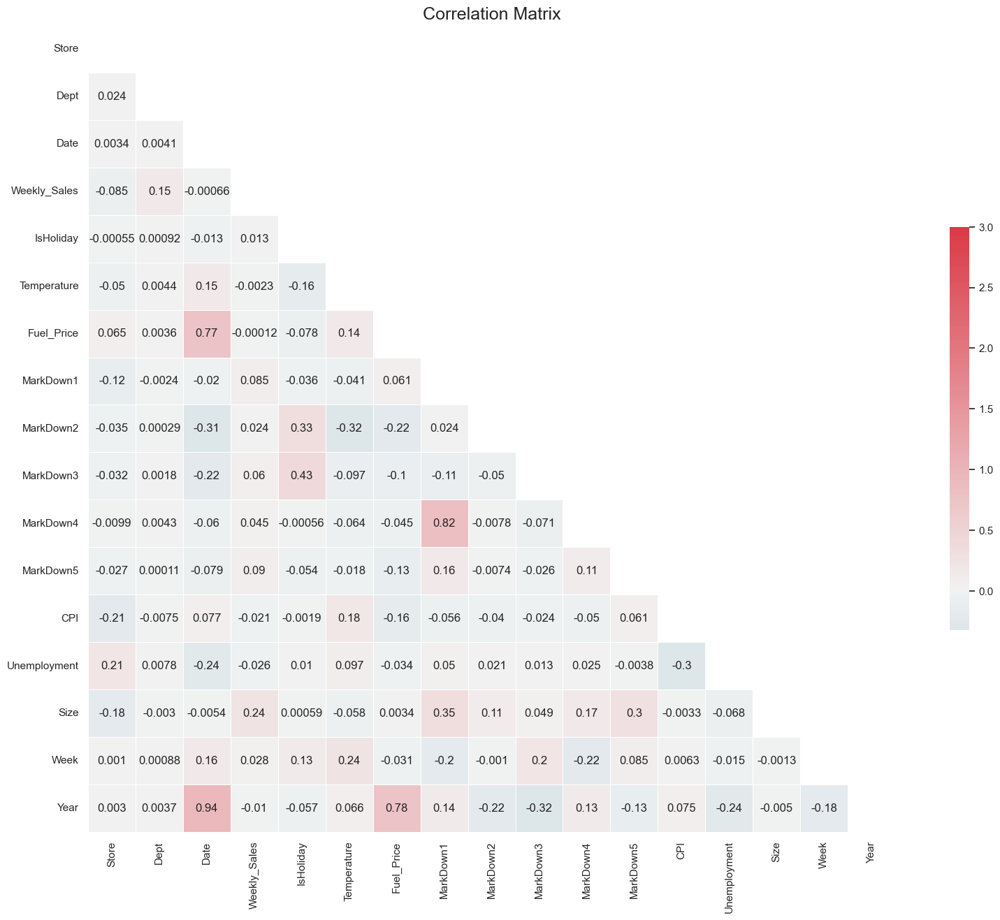

In [60]:
train_merge1=train_merge.drop('Type', axis=1)
sns.set(style='white')
corr= train_merge1.corr(numeric_only=True)
mask= np.triu(np.ones_like(corr, dtype=bool))
f, ax= plt.subplots(figsize=(20,15))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
plt.title('Correlation Matrix', fontsize=18)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=3, center=0, square=True, linewidths=.5, cbar_kws={'shrink': .5}, annot=True)
plt.show


In [61]:
#Dropping down the varialbles that have weak correlation
train_merge = train_merge.drop(columns=['Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5'])
test_merge = test_merge.drop(columns=['Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5'])

In [62]:
train_merge.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Temperature,CPI,Unemployment,Type,Size,Week,Year
0,1,1,1265328000000000000,24924.50,False,42.31,211.096358,8.106,NaN,151315,5,2010
1,1,1,1265932800000000000,46039.49,True,38.51,211.242170,8.106,NaN,151315,6,2010
2,1,1,1266537600000000000,41595.55,False,39.93,211.289143,8.106,NaN,151315,7,2010
3,1,1,1267142400000000000,19403.54,False,46.63,211.319643,8.106,NaN,151315,8,2010
4,1,1,1267747200000000000,21827.90,False,46.50,211.350143,8.106,NaN,151315,9,2010


In [63]:
test_merge.head()

,Store,Dept,Date,IsHoliday,Temperature,CPI,Unemployment,Type,Size,Week,Year
0,1,1,2012-11-02,False,55.32,223.462779,6.573,A,151315,44,2012
1,1,1,2012-11-09,False,61.24,223.481307,6.573,A,151315,45,2012
2,1,1,2012-11-16,False,52.92,223.512911,6.573,A,151315,46,2012
3,1,1,2012-11-23,True,56.23,223.561947,6.573,A,151315,47,2012
4,1,1,2012-11-30,False,52.34,223.610984,6.573,A,151315,48,2012


In [64]:
#Counting the number of unique values
train_df['Dept'].nunique()


81

In [65]:
#Counting the number of unique values
train_df['Store'].nunique()

45

In [66]:
#Getting the columns in the train_merge
train_merge.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'CPI', 'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

In [67]:
#Getting the columns in the test_merge
test_merge.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday', 'Temperature', 'CPI',
       'Unemployment', 'Type', 'Size', 'Week', 'Year'],
      dtype='object')

#### Dividing the data into Train and Test

In [69]:
x = train_merge[['Store', 'Dept', 'IsHoliday', 'Size', 'Week', 'Year']] #selecting the values to be taken in the x
y= train_merge['Weekly_Sales']

### Model Building

In [71]:
#splitting the data into Train and Test 
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y, test_size= 0.2, random_state= 42)

In [72]:
#Performing GridSearchCV on Ridge Regression
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

params = {'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
ridge_regressor = GridSearchCV(Ridge(), params, cv= 7, scoring='neg_mean_absolute_error', n_jobs = -1)
ridge_regressor.fit(x_train, y_train)

GridSearchCV(cv=7, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                                   10000, 100000]},
             scoring='neg_mean_absolute_error')

In [73]:
#predicting  train and test results
y_train_pred= ridge_regressor.predict(x_train)
y_test_pred =ridge_regressor.predict(x_test)

In [74]:
from math import sqrt
from sklearn.metrics import root_mean_squared_error as mse
from sklearn.metrics import r2_score
print("Train Results for Ridge Regression Model:")
print("Root Mean Squared Error: ", sqrt(mse(y_train.values, y_train_pred)))
print("R-squared", r2_score(y_train.values, y_train_pred))


Train Results for Ridge Regression Model:
Root Mean Squared Error:  147.33299195348766
R-squared 0.08395327010913711


In [75]:
print("Test Results for Ridge Regression Model:")
print("Root Mean Squared Error: ", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared", r2_score(y_test.values, y_test_pred))


Test Results for Ridge Regression Model:
Root Mean Squared Error:  147.7378987049937
R-squared 0.08643907566701214


In [76]:
#Performing GridSearchCV  on Lasso Regression
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

params = {'alpha' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
Lasso_regressor = GridSearchCV(Lasso(), params, cv= 15, scoring='neg_mean_absolute_error', n_jobs = -1)
Lasso_regressor.fit(x_train, y_train)

GridSearchCV(cv=15, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                                   10000, 100000]},
             scoring='neg_mean_absolute_error')

In [77]:
#Predicting train and test Results
y_train_pred= ridge_regressor.predict(x_train)
y_test_pred =ridge_regressor.predict(x_test)

In [78]:
print("Train Results for Lasso Regressor Model:")
print("Root Mean Squared Error: ", sqrt(mse(y_train.values, y_train_pred)))
print("R-squared", r2_score(y_train.values, y_train_pred))


Train Results for Lasso Regressor Model:
Root Mean Squared Error:  147.33299195348766
R-squared 0.08395327010913711


In [79]:
print("Test Results for Lasso Regression Model:")
print("Root Mean Squared Error: ", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared", r2_score(y_test.values, y_test_pred))


Test Results for Lasso Regression Model:
Root Mean Squared Error:  147.7378987049937
R-squared 0.08643907566701214


In [80]:
#Performing GridSearchCV on Decision Tree Regression
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
import numpy as np
depth = list(range(3,30))

param_grid = dict(max_depth = depth)
tree = GridSearchCV(DecisionTreeRegressor(), param_grid, n_jobs=-1, cv = 10)
tree.fit(x_train, y_train)


GridSearchCV(cv=10, estimator=DecisionTreeRegressor(), n_jobs=-1,
             param_grid={'max_depth': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,
                                       15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                       25, 26, 27, 28, 29]})

In [81]:
#predicting train and test results
y_train_pred= tree.predict(x_train)

y_test_pred= tree.predict(x_test)

In [82]:
print("Test Results for Decision Tree Regressor Model:")
print("Root Mean Squared Error: ", sqrt(mse(y_test.values, y_test_pred)))
print("R-squared", r2_score(y_test.values, y_test_pred))


Test Results for Decision Tree Regressor Model:
Root Mean Squared Error:  64.88426146977413
R-squared 0.9660118671272607
